In [1]:
#import packages
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
%matplotlib inline
from sklearn.tree import DecisionTreeRegressor
from sklearn.linear_model import LinearRegression
from sklearn.model_selection import  KFold
from sklearn.metrics import mean_absolute_error
from sklearn.model_selection import cross_val_score
from numpy import mean
from numpy import std
from sklearn.feature_selection import RFE
import operator
import seaborn as sns
from scipy import stats
from sklearn.experimental import enable_iterative_imputer
from sklearn.impute import IterativeImputer
from sklearn.neighbors import KNeighborsRegressor
import joblib
from sklearn.model_selection import train_test_split
from sklearn.metrics import mean_absolute_error
from sklearn import linear_model
from sklearn import svm
from sklearn import neighbors
from sklearn.ensemble import GradientBoostingRegressor
from sklearn.experimental import enable_hist_gradient_boosting
from sklearn.ensemble import HistGradientBoostingRegressor
from lightgbm import LGBMRegressor
from xgboost import XGBRegressor
from catboost import CatBoostRegressor
from sklearn.preprocessing import StandardScaler
from sklearn.metrics import r2_score
from itertools import combinations
from sklearn.metrics import accuracy_score
from sklearn.metrics import confusion_matrix
from sklearn.datasets import make_classification
from sklearn.model_selection import cross_val_predict
from imblearn.over_sampling import SVMSMOTE
from sklearn.model_selection import cross_validate
from sklearn.ensemble import AdaBoostClassifier
from sklearn.ensemble import RandomForestClassifier
from sklearn.ensemble import BaggingClassifier
from xgboost import XGBClassifier
from sklearn import metrics
from sklearn import svm
from sklearn.linear_model import LogisticRegression
from imblearn.over_sampling import BorderlineSMOTE
from imblearn.over_sampling import ADASYN
from sklearn.feature_selection import RFE
from sklearn.tree import DecisionTreeClassifier
from sklearn.pipeline import Pipeline
from sklearn.model_selection import GridSearchCV
import category_encoders as ce
from sklearn.experimental import enable_iterative_imputer
from sklearn.impute import IterativeImputer
from sklearn.preprocessing import StandardScaler
from sklearn.naive_bayes import GaussianNB 
from sklearn.naive_bayes import BernoulliNB
import pandasql as ps
from sklearn.model_selection import RepeatedStratifiedKFold
import os

import warnings
warnings.simplefilter(action='ignore', category=FutureWarning)

/Library/Frameworks/Python.framework/Versions/3.8/lib/python3.8/site-packages/sklearn/experimental/enable_hist_gradient_boosting.py:16: UserWarning: Since version 1.0, it is not needed to import enable_hist_gradient_boosting anymore. HistGradientBoostingClassifier and HistGradientBoostingRegressor are now stable and can be normally imported from sklearn.ensemble.
  warnings.warn(


In [54]:
df = pd.read_csv(f"/Users/{os.environ['USER']}/Documents/Uni/Szakdoga/Adatok/TRAIN_CLEARED2.csv")
df = df.drop(['Unnamed: 0'], axis=1)

In [44]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 11028 entries, 0 to 11027
Data columns (total 48 columns):
 #   Column                                       Non-Null Count  Dtype  
---  ------                                       --------------  -----  
 0   NewName                                      11028 non-null  object 
 1   ClubInvolved                                 11028 non-null  object 
 2   League                                       11028 non-null  object 
 3   MainPosition                                 11028 non-null  object 
 4   LeagueInvolved                               11028 non-null  object 
 5   CorrMarketValue                              11028 non-null  float64
 6   Country                                      11028 non-null  object 
 7   Club                                         11028 non-null  object 
 8   Position                                     11028 non-null  object 
 9   Foot                                         11028 non-null  object 
 10

In [55]:
df = df.drop(['NewName', 'ClubInvolved', 'Club', 'ClubAge', 'ClubNumPlayersUsedPerMatch',\
     'ClubGoalPerShotOnTargetPerMatch', 'ClubShotOnTargetAgainstUsedPerMatch', 'ClubPointsPerMatch', 'Fee'], axis = 1)

In [46]:
df.columns

Index(['League', 'MainPosition', 'LeagueInvolved', 'CorrMarketValue',
       'Country', 'Position', 'Foot', 'IntReputation', 'Heading_accuracy',
       'Reactions', 'Balance', 'Jumping', 'Season', 'Years', 'DEGREE', 'Eigv',
       'SP_LA_LIGA', 'EN_PL', 'IT_SERIE_A', 'FR_LIGUE_1', 'GE_BUNDESLIGA',
       'ClubInvolvedAge', 'ClubInvolvedCleanSheetsRate', 'MinutesPlayedPer90',
       'ContractLeft', 'Pace_main', 'Shooting_main', 'Defending_main',
       'Passing_main', 'Physical_main', 'Age', 'ClubInvolvedPointsPerMatch',
       'ClubInvolvedNumPlayersUsedPerMatch',
       'ClubInvolvedGoalPerShotOnTargetPerMatch',
       'ClubInvolvedShotOnTargetAgainstUsedPerMatch', 'GoalsPerMinutesPlayed',
       'AssistsPerMinutesPlayed', 'YellowCardsPerMinutesPlayed',
       'RedCardsPerMinutesPlayed'],
      dtype='object')

In [56]:
df['target'] = 0
df.loc[df.League == 'French Ligue 1', 'target'] = 1

In [57]:
df = df.drop('League', axis=1)

In [49]:
df['target'].value_counts()

0    10037
1      991
Name: target, dtype: int64

/var/folders/8m/8q13t9cn0917nvwcf017zkbc0000gn/T/ipykernel_29055/2110162785.py:16: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  f = plt.figure(figsize=(6,4))


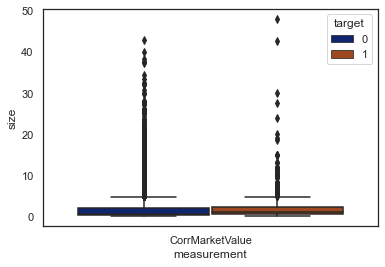

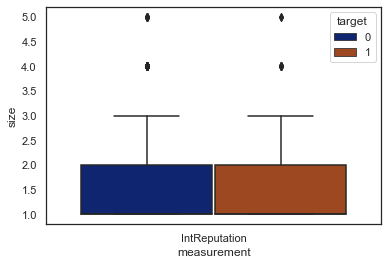

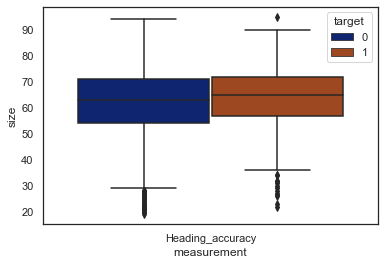

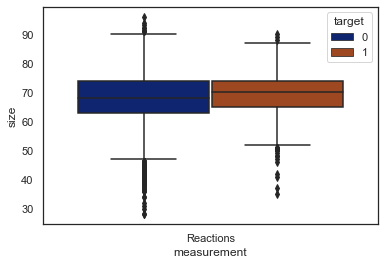

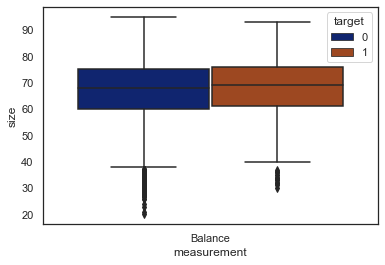

...

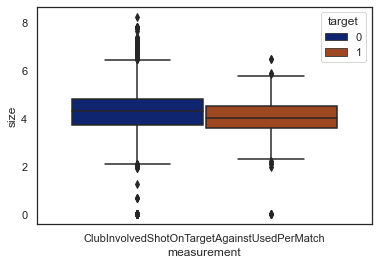

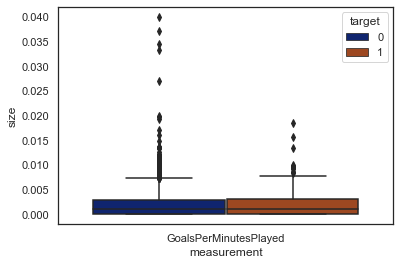

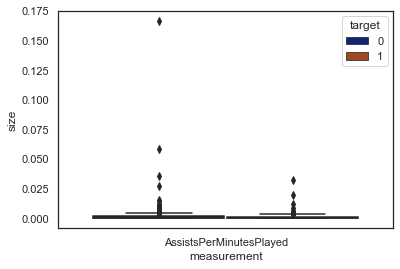

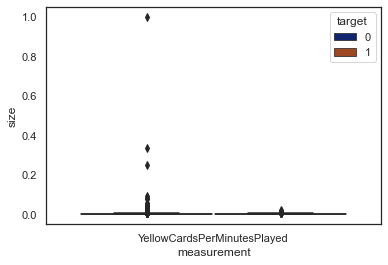

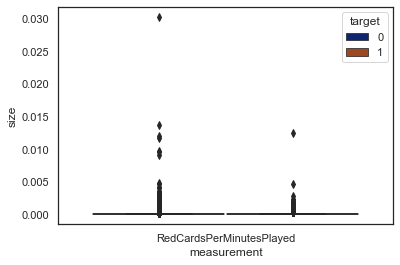

In [33]:
numeric_cols = df.select_dtypes(['number'])
for col in numeric_cols:
    try:
        plot_data = (df[[col, 'target']]
                .set_index('target')
                .stack()
                .to_frame()
                .reset_index()
                .rename(columns={0:'size', 'level_1':'measurement'})
                )
        
        sns.set_style('white')
        sns.set_context('notebook')
        sns.set_palette('dark')

        f = plt.figure(figsize=(6,4))
        sns.boxplot(x='measurement', y='size', 
            hue='target', data=plot_data);
    except:
        pass

In [58]:
# Create a list of float colums to check for skewing
mask = df.dtypes == np.float
float_cols = df.columns[mask]

skew_limit = 0.75 # define a limit above which we will log transform
skew_vals = df[float_cols].skew()

/var/folders/8m/8q13t9cn0917nvwcf017zkbc0000gn/T/ipykernel_29055/2578076629.py:2: DeprecationWarning: `np.float` is a deprecated alias for the builtin `float`. To silence this warning, use `float` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.float64` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  mask = df.dtypes == np.float


In [59]:
# Showing the skewed columns
skew_cols = (skew_vals
             .sort_values(ascending=False)
             .to_frame()
             .rename(columns={0:'Skew'})
             .query('abs(Skew) > {}'.format(skew_limit)))

skew_cols

,Skew
YellowCardsPerMinutesPlayed,61.200120
AssistsPerMinutesPlayed,41.091123
RedCardsPerMinutesPlayed,23.333195
CorrMarketValue,4.562480
GoalsPerMinutesPlayed,3.291962
Eigv,2.171062
ClubInvolvedNumPlayersUsedPerMatch,1.947725
ClubInvolvedGoalPerShotOnTargetPerMatch,0.880051


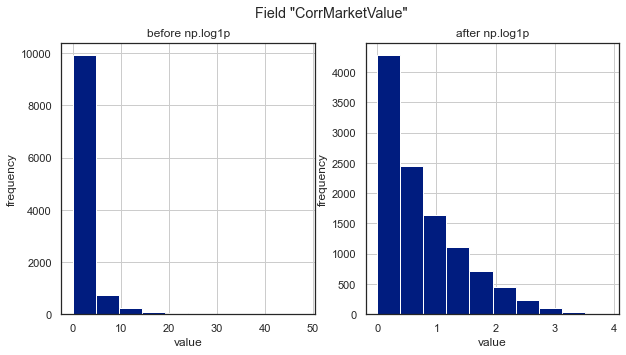

In [60]:
# Let's look at what happens to one of these features, when we apply np.log1p visually.

# Choose a field
field = "CorrMarketValue"

# Create two "subplots" and a "figure" using matplotlib
fig, (ax_before, ax_after) = plt.subplots(1, 2, figsize=(10, 5))

# Create a histogram on the "ax_before" subplot
df[field].hist(ax=ax_before)

# Apply a log transformation (numpy syntax) to this column
df[field].apply(np.log1p).hist(ax=ax_after)

# Formatting of titles etc. for each subplot
ax_before.set(title='before np.log1p', ylabel='frequency', xlabel='value')
ax_after.set(title='after np.log1p', ylabel='frequency', xlabel='value')
fig.suptitle('Field "{}"'.format(field));

In [61]:
# Perform the skew transformation:

for col in skew_cols.index.values:
    if col == "CorrMarketValue":
        continue
    df[col] = df[col].apply(np.log1p)

In [68]:
df.describe().T

,count,mean,std,min,25%,50%,75%,max
CorrMarketValue,11028.0,1.885296,3.260456,0.000000,0.250000,0.750000,2.127660,48.000000
IntReputation,11028.0,1.485219,0.729024,1.000000,1.000000,1.000000,2.000000,5.000000
Heading_accuracy,11028.0,62.096391,12.220899,19.000000,54.000000,63.000000,71.000000,95.000000
Reactions,11028.0,68.027566,8.263237,28.000000,63.000000,69.000000,74.000000,96.000000
Balance,8596.0,67.096440,12.281188,20.000000,60.000000,68.000000,75.000000,95.000000
Jumping,8596.0,67.931131,11.061093,25.000000,61.000000,69.000000,75.000000,95.000000
Season,11028.0,2014.484947,4.026895,2008.000000,2011.000000,2015.000000,2018.000000,2021.000000
Years,11028.0,2.171654,1.036649,1.000000,2.000000,2.000000,2.000000,12.000000
DEGREE,11028.0,9.962550,8.861302,0.000000,0.000000,10.000000,17.000000,37.000000
Eigv,11028.0,0.005841,0.008344,0.000000,0.000000,0.002261,0.008750,0.071700


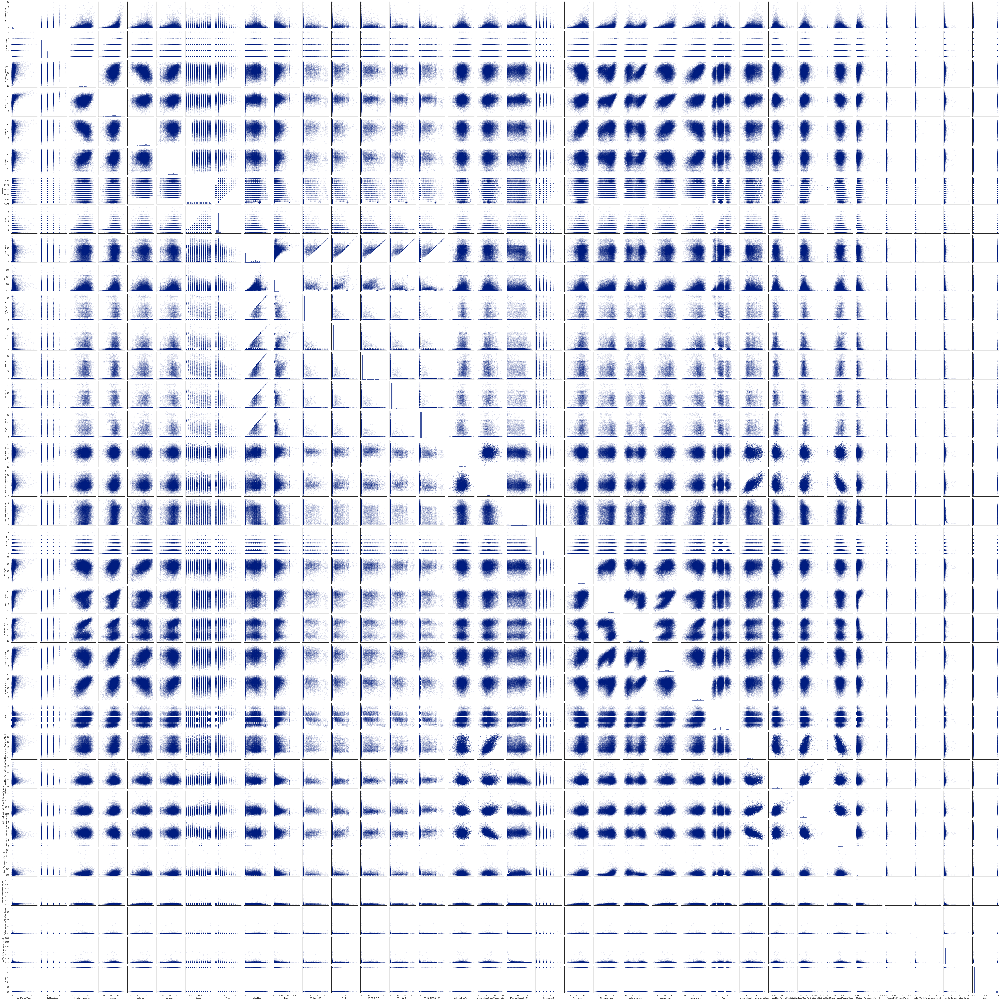

In [69]:
sns.pairplot(df, plot_kws=dict(alpha=.1, edgecolor='none'))

In [62]:
#set feature list and target
feature_list = list(df.columns.values)
feature_list.remove('target')
target = 'target'

# define dataset
X = df[feature_list]
y = df[target]

In [63]:
import category_encoders as ce
#encoding the categorival variables using target encoding
cbe_encoder = ce.cat_boost.CatBoostEncoder()
X_cbe = cbe_encoder.fit_transform(X,y)

In [64]:
#Impute missing values
imputer = IterativeImputer()
imputer.fit(X_cbe)
X_imp = imputer.transform(X_cbe)
X_imp = pd.DataFrame(data = X_imp, columns = X_cbe.columns)

In [65]:
#standardization 
scaler = StandardScaler()
X_imp_st = scaler.fit_transform(X_imp)
X_imp_st = pd.DataFrame(data = X_imp_st, columns=X_imp.columns)

In [66]:

# define the model
model = XGBClassifier(n_estimators=50, random_state=1)

# define the evaluation method
cv = RepeatedStratifiedKFold(n_splits=10, n_repeats=2, random_state=1)

#scoring params
scoring = {'acc': 'accuracy',
           'recall': 'recall',
           'auc': 'roc_auc',
           'precison': 'precision',
           'f1': 'f1'}

# evaluate the model on the dataset
n_scores = cross_validate(model, X_imp_st , y, scoring=scoring, cv=cv, n_jobs=-1, return_train_score= False)

# report performance
for key, value in n_scores.items():
    print(key, mean(value))

/Library/Frameworks/Python.framework/Versions/3.8/lib/python3.8/site-packages/xgboost/sklearn.py:1146: UserWarning: The use of label encoder in XGBClassifier is deprecated and will be removed in a future release. To remove this warning, do the following: 1) Pass option use_label_encoder=False when constructing XGBClassifier object; and 2) Encode your labels (y) as integers starting with 0, i.e. 0, 1, 2, ..., [num_class - 1].
  warnings.warn(label_encoder_deprecation_msg, UserWarning)
/Library/Frameworks/Python.framework/Versions/3.8/lib/python3.8/site-packages/xgboost/sklearn.py:1146: UserWarning: The use of label encoder in XGBClassifier is deprecated and will be removed in a future release. To remove this warning, do the following: 1) Pass option use_label_encoder=False when constructing XGBClassifier object; and 2) Encode your labels (y) as integers starting with 0, i.e. 0, 1, 2, ..., [num_class - 1].
  warnings.warn(label_encoder_deprecation_msg, UserWarning)
/Library/Frameworks/Py

[22:03:50] WARNING: /Users/travis/build/dmlc/xgboost/src/learner.cc:1095: Starting in XGBoost 1.3.0, the default evaluation metric used with the objective 'binary:logistic' was changed from 'error' to 'logloss'. Explicitly set eval_metric if you'd like to restore the old behavior.
[22:03:50] WARNING: /Users/travis/build/dmlc/xgboost/src/learner.cc:1095: Starting in XGBoost 1.3.0, the default evaluation metric used with the objective 'binary:logistic' was changed from 'error' to 'logloss'. Explicitly set eval_metric if you'd like to restore the old behavior.
[22:03:50] WARNING: /Users/travis/build/dmlc/xgboost/src/learner.cc:1095: Starting in XGBoost 1.3.0, the default evaluation metric used with the objective 'binary:logistic' was changed from 'error' to 'logloss'. Explicitly set eval_metric if you'd like to restore the old behavior.
[22:03:50] WARNING: /Users/travis/build/dmlc/xgboost/src/learner.cc:1095: Starting in XGBoost 1.3.0, the default evaluation metric used with the objective

/Library/Frameworks/Python.framework/Versions/3.8/lib/python3.8/site-packages/xgboost/data.py:112: UserWarning: Use subset (sliced data) of np.ndarray is not recommended because it will generate extra copies and increase memory consumption
  warnings.warn(
/Library/Frameworks/Python.framework/Versions/3.8/lib/python3.8/site-packages/xgboost/data.py:112: UserWarning: Use subset (sliced data) of np.ndarray is not recommended because it will generate extra copies and increase memory consumption
  warnings.warn(
/Library/Frameworks/Python.framework/Versions/3.8/lib/python3.8/site-packages/xgboost/data.py:112: UserWarning: Use subset (sliced data) of np.ndarray is not recommended because it will generate extra copies and increase memory consumption
  warnings.warn(
/Library/Frameworks/Python.framework/Versions/3.8/lib/python3.8/site-packages/xgboost/data.py:112: UserWarning: Use subset (sliced data) of np.ndarray is not recommended because it will generate extra copies and increase memory c

[22:04:05] WARNING: /Users/travis/build/dmlc/xgboost/src/learner.cc:1095: Starting in XGBoost 1.3.0, the default evaluation metric used with the objective 'binary:logistic' was changed from 'error' to 'logloss'. Explicitly set eval_metric if you'd like to restore the old behavior.
[22:04:05] WARNING: /Users/travis/build/dmlc/xgboost/src/learner.cc:1095: Starting in XGBoost 1.3.0, the default evaluation metric used with the objective 'binary:logistic' was changed from 'error' to 'logloss'. Explicitly set eval_metric if you'd like to restore the old behavior.
[22:04:05] WARNING: /Users/travis/build/dmlc/xgboost/src/learner.cc:1095: Starting in XGBoost 1.3.0, the default evaluation metric used with the objective 'binary:logistic' was changed from 'error' to 'logloss'. Explicitly set eval_metric if you'd like to restore the old behavior.
[22:04:06] WARNING: /Users/travis/build/dmlc/xgboost/src/learner.cc:1095: Starting in XGBoost 1.3.0, the default evaluation metric used with the objective

/Library/Frameworks/Python.framework/Versions/3.8/lib/python3.8/site-packages/xgboost/data.py:112: UserWarning: Use subset (sliced data) of np.ndarray is not recommended because it will generate extra copies and increase memory consumption
  warnings.warn(
/Library/Frameworks/Python.framework/Versions/3.8/lib/python3.8/site-packages/xgboost/data.py:112: UserWarning: Use subset (sliced data) of np.ndarray is not recommended because it will generate extra copies and increase memory consumption
  warnings.warn(
/Library/Frameworks/Python.framework/Versions/3.8/lib/python3.8/site-packages/xgboost/data.py:112: UserWarning: Use subset (sliced data) of np.ndarray is not recommended because it will generate extra copies and increase memory consumption
  warnings.warn(
/Library/Frameworks/Python.framework/Versions/3.8/lib/python3.8/site-packages/xgboost/data.py:112: UserWarning: Use subset (sliced data) of np.ndarray is not recommended because it will generate extra copies and increase memory c

[22:04:15] WARNING: /Users/travis/build/dmlc/xgboost/src/learner.cc:1095: Starting in XGBoost 1.3.0, the default evaluation metric used with the objective 'binary:logistic' was changed from 'error' to 'logloss'. Explicitly set eval_metric if you'd like to restore the old behavior.
[22:04:15] WARNING: /Users/travis/build/dmlc/xgboost/src/learner.cc:1095: Starting in XGBoost 1.3.0, the default evaluation metric used with the objective 'binary:logistic' was changed from 'error' to 'logloss'. Explicitly set eval_metric if you'd like to restore the old behavior.
[22:04:15] WARNING: /Users/travis/build/dmlc/xgboost/src/learner.cc:1095: Starting in XGBoost 1.3.0, the default evaluation metric used with the objective 'binary:logistic' was changed from 'error' to 'logloss'. Explicitly set eval_metric if you'd like to restore the old behavior.


/Library/Frameworks/Python.framework/Versions/3.8/lib/python3.8/site-packages/xgboost/sklearn.py:1146: UserWarning: The use of label encoder in XGBClassifier is deprecated and will be removed in a future release. To remove this warning, do the following: 1) Pass option use_label_encoder=False when constructing XGBClassifier object; and 2) Encode your labels (y) as integers starting with 0, i.e. 0, 1, 2, ..., [num_class - 1].
  warnings.warn(label_encoder_deprecation_msg, UserWarning)


[22:04:15] WARNING: /Users/travis/build/dmlc/xgboost/src/learner.cc:1095: Starting in XGBoost 1.3.0, the default evaluation metric used with the objective 'binary:logistic' was changed from 'error' to 'logloss'. Explicitly set eval_metric if you'd like to restore the old behavior.


/Library/Frameworks/Python.framework/Versions/3.8/lib/python3.8/site-packages/xgboost/data.py:112: UserWarning: Use subset (sliced data) of np.ndarray is not recommended because it will generate extra copies and increase memory consumption
  warnings.warn(
/Library/Frameworks/Python.framework/Versions/3.8/lib/python3.8/site-packages/xgboost/data.py:112: UserWarning: Use subset (sliced data) of np.ndarray is not recommended because it will generate extra copies and increase memory consumption
  warnings.warn(
/Library/Frameworks/Python.framework/Versions/3.8/lib/python3.8/site-packages/xgboost/sklearn.py:1146: UserWarning: The use of label encoder in XGBClassifier is deprecated and will be removed in a future release. To remove this warning, do the following: 1) Pass option use_label_encoder=False when constructing XGBClassifier object; and 2) Encode your labels (y) as integers starting with 0, i.e. 0, 1, 2, ..., [num_class - 1].
  warnings.warn(label_encoder_deprecation_msg, UserWarnin

[22:04:24] WARNING: /Users/travis/build/dmlc/xgboost/src/learner.cc:1095: Starting in XGBoost 1.3.0, the default evaluation metric used with the objective 'binary:logistic' was changed from 'error' to 'logloss'. Explicitly set eval_metric if you'd like to restore the old behavior.
[22:04:24] WARNING: /Users/travis/build/dmlc/xgboost/src/learner.cc:1095: Starting in XGBoost 1.3.0, the default evaluation metric used with the objective 'binary:logistic' was changed from 'error' to 'logloss'. Explicitly set eval_metric if you'd like to restore the old behavior.


/Library/Frameworks/Python.framework/Versions/3.8/lib/python3.8/site-packages/xgboost/sklearn.py:1146: UserWarning: The use of label encoder in XGBClassifier is deprecated and will be removed in a future release. To remove this warning, do the following: 1) Pass option use_label_encoder=False when constructing XGBClassifier object; and 2) Encode your labels (y) as integers starting with 0, i.e. 0, 1, 2, ..., [num_class - 1].
  warnings.warn(label_encoder_deprecation_msg, UserWarning)
/Library/Frameworks/Python.framework/Versions/3.8/lib/python3.8/site-packages/xgboost/data.py:112: UserWarning: Use subset (sliced data) of np.ndarray is not recommended because it will generate extra copies and increase memory consumption
  warnings.warn(
/Library/Frameworks/Python.framework/Versions/3.8/lib/python3.8/site-packages/xgboost/data.py:112: UserWarning: Use subset (sliced data) of np.ndarray is not recommended because it will generate extra copies and increase memory consumption
  warnings.war

[22:04:25] WARNING: /Users/travis/build/dmlc/xgboost/src/learner.cc:1095: Starting in XGBoost 1.3.0, the default evaluation metric used with the objective 'binary:logistic' was changed from 'error' to 'logloss'. Explicitly set eval_metric if you'd like to restore the old behavior.
[22:04:25] WARNING: /Users/travis/build/dmlc/xgboost/src/learner.cc:1095: Starting in XGBoost 1.3.0, the default evaluation metric used with the objective 'binary:logistic' was changed from 'error' to 'logloss'. Explicitly set eval_metric if you'd like to restore the old behavior.


/Library/Frameworks/Python.framework/Versions/3.8/lib/python3.8/site-packages/xgboost/data.py:112: UserWarning: Use subset (sliced data) of np.ndarray is not recommended because it will generate extra copies and increase memory consumption
  warnings.warn(
/Library/Frameworks/Python.framework/Versions/3.8/lib/python3.8/site-packages/xgboost/data.py:112: UserWarning: Use subset (sliced data) of np.ndarray is not recommended because it will generate extra copies and increase memory consumption
  warnings.warn(
/Library/Frameworks/Python.framework/Versions/3.8/lib/python3.8/site-packages/xgboost/sklearn.py:1146: UserWarning: The use of label encoder in XGBClassifier is deprecated and will be removed in a future release. To remove this warning, do the following: 1) Pass option use_label_encoder=False when constructing XGBClassifier object; and 2) Encode your labels (y) as integers starting with 0, i.e. 0, 1, 2, ..., [num_class - 1].
  warnings.warn(label_encoder_deprecation_msg, UserWarnin

[22:04:34] WARNING: /Users/travis/build/dmlc/xgboost/src/learner.cc:1095: Starting in XGBoost 1.3.0, the default evaluation metric used with the objective 'binary:logistic' was changed from 'error' to 'logloss'. Explicitly set eval_metric if you'd like to restore the old behavior.
[22:04:34] WARNING: /Users/travis/build/dmlc/xgboost/src/learner.cc:1095: Starting in XGBoost 1.3.0, the default evaluation metric used with the objective 'binary:logistic' was changed from 'error' to 'logloss'. Explicitly set eval_metric if you'd like to restore the old behavior.
[22:04:34] WARNING: /Users/travis/build/dmlc/xgboost/src/learner.cc:1095: Starting in XGBoost 1.3.0, the default evaluation metric used with the objective 'binary:logistic' was changed from 'error' to 'logloss'. Explicitly set eval_metric if you'd like to restore the old behavior.


/Library/Frameworks/Python.framework/Versions/3.8/lib/python3.8/site-packages/xgboost/data.py:112: UserWarning: Use subset (sliced data) of np.ndarray is not recommended because it will generate extra copies and increase memory consumption
  warnings.warn(
/Library/Frameworks/Python.framework/Versions/3.8/lib/python3.8/site-packages/xgboost/data.py:112: UserWarning: Use subset (sliced data) of np.ndarray is not recommended because it will generate extra copies and increase memory consumption
  warnings.warn(
/Library/Frameworks/Python.framework/Versions/3.8/lib/python3.8/site-packages/xgboost/sklearn.py:1146: UserWarning: The use of label encoder in XGBClassifier is deprecated and will be removed in a future release. To remove this warning, do the following: 1) Pass option use_label_encoder=False when constructing XGBClassifier object; and 2) Encode your labels (y) as integers starting with 0, i.e. 0, 1, 2, ..., [num_class - 1].
  warnings.warn(label_encoder_deprecation_msg, UserWarnin

[22:04:35] WARNING: /Users/travis/build/dmlc/xgboost/src/learner.cc:1095: Starting in XGBoost 1.3.0, the default evaluation metric used with the objective 'binary:logistic' was changed from 'error' to 'logloss'. Explicitly set eval_metric if you'd like to restore the old behavior.


/Library/Frameworks/Python.framework/Versions/3.8/lib/python3.8/site-packages/xgboost/data.py:112: UserWarning: Use subset (sliced data) of np.ndarray is not recommended because it will generate extra copies and increase memory consumption
  warnings.warn(
/Library/Frameworks/Python.framework/Versions/3.8/lib/python3.8/site-packages/xgboost/data.py:112: UserWarning: Use subset (sliced data) of np.ndarray is not recommended because it will generate extra copies and increase memory consumption
  warnings.warn(
/Library/Frameworks/Python.framework/Versions/3.8/lib/python3.8/site-packages/xgboost/data.py:112: UserWarning: Use subset (sliced data) of np.ndarray is not recommended because it will generate extra copies and increase memory consumption
  warnings.warn(
/Library/Frameworks/Python.framework/Versions/3.8/lib/python3.8/site-packages/xgboost/data.py:112: UserWarning: Use subset (sliced data) of np.ndarray is not recommended because it will generate extra copies and increase memory c

fit_time 10.629488968849182
score_time 0.06033345460891724
test_acc 0.9263232760677449
test_recall 0.3758737373737373
test_auc 0.8906317294845711
test_precison 0.6607886179961213
test_f1 0.4779929912028143


/Library/Frameworks/Python.framework/Versions/3.8/lib/python3.8/site-packages/xgboost/data.py:112: UserWarning: Use subset (sliced data) of np.ndarray is not recommended because it will generate extra copies and increase memory consumption
  warnings.warn(
/Library/Frameworks/Python.framework/Versions/3.8/lib/python3.8/site-packages/xgboost/data.py:112: UserWarning: Use subset (sliced data) of np.ndarray is not recommended because it will generate extra copies and increase memory consumption
  warnings.warn(


In [67]:
# report performance
for key, value in n_scores.items():
    print(key, mean(value))

fit_time 10.629488968849182
score_time 0.06033345460891724
test_acc 0.9263232760677449
test_recall 0.3758737373737373
test_auc 0.8906317294845711
test_precison 0.6607886179961213
test_f1 0.4779929912028143


In [39]:
# report performance
for key, value in n_scores.items():
    print(key, mean(value))

fit_time 13.139121949672699
score_time 0.08155503273010253
test_acc 0.928409649972933
test_recall 0.38902525252525255
test_auc 0.8880063205088746
test_precison 0.6813691163368543
test_f1 0.49386610143661186


In [41]:

# define the model
model = XGBClassifier(n_estimators=50, random_state=1)

# define the evaluation method
cv = RepeatedStratifiedKFold(n_splits=10, n_repeats=2, random_state=1)

#scoring params
scoring = {'acc': 'accuracy',
           'recall': 'recall',
           'auc': 'roc_auc',
           'precison': 'precision',
           'f1': 'f1'}

# evaluate the model on the dataset
n_scores = cross_validate(model, X_imp_st.drop(['IntReputation', 'Season', 'ContractLeft'], axis = 1) , y, scoring=scoring, cv=cv, n_jobs=-1, return_train_score= False)

# report performance
for key, value in n_scores.items():
    print(key, mean(value))

/Library/Frameworks/Python.framework/Versions/3.8/lib/python3.8/site-packages/xgboost/sklearn.py:1146: UserWarning: The use of label encoder in XGBClassifier is deprecated and will be removed in a future release. To remove this warning, do the following: 1) Pass option use_label_encoder=False when constructing XGBClassifier object; and 2) Encode your labels (y) as integers starting with 0, i.e. 0, 1, 2, ..., [num_class - 1].
  warnings.warn(label_encoder_deprecation_msg, UserWarning)
/Library/Frameworks/Python.framework/Versions/3.8/lib/python3.8/site-packages/xgboost/sklearn.py:1146: UserWarning: The use of label encoder in XGBClassifier is deprecated and will be removed in a future release. To remove this warning, do the following: 1) Pass option use_label_encoder=False when constructing XGBClassifier object; and 2) Encode your labels (y) as integers starting with 0, i.e. 0, 1, 2, ..., [num_class - 1].
  warnings.warn(label_encoder_deprecation_msg, UserWarning)
/Library/Frameworks/Py

[17:22:15] WARNING: /Users/travis/build/dmlc/xgboost/src/learner.cc:1095: Starting in XGBoost 1.3.0, the default evaluation metric used with the objective 'binary:logistic' was changed from 'error' to 'logloss'. Explicitly set eval_metric if you'd like to restore the old behavior.
[17:22:15] WARNING: /Users/travis/build/dmlc/xgboost/src/learner.cc:1095: Starting in XGBoost 1.3.0, the default evaluation metric used with the objective 'binary:logistic' was changed from 'error' to 'logloss'. Explicitly set eval_metric if you'd like to restore the old behavior.
[17:22:15] WARNING: /Users/travis/build/dmlc/xgboost/src/learner.cc:1095: Starting in XGBoost 1.3.0, the default evaluation metric used with the objective 'binary:logistic' was changed from 'error' to 'logloss'. Explicitly set eval_metric if you'd like to restore the old behavior.
[17:22:15] WARNING: /Users/travis/build/dmlc/xgboost/src/learner.cc:1095: Starting in XGBoost 1.3.0, the default evaluation metric used with the objective

/Library/Frameworks/Python.framework/Versions/3.8/lib/python3.8/site-packages/xgboost/data.py:112: UserWarning: Use subset (sliced data) of np.ndarray is not recommended because it will generate extra copies and increase memory consumption
  warnings.warn(
/Library/Frameworks/Python.framework/Versions/3.8/lib/python3.8/site-packages/xgboost/data.py:112: UserWarning: Use subset (sliced data) of np.ndarray is not recommended because it will generate extra copies and increase memory consumption
  warnings.warn(
/Library/Frameworks/Python.framework/Versions/3.8/lib/python3.8/site-packages/xgboost/data.py:112: UserWarning: Use subset (sliced data) of np.ndarray is not recommended because it will generate extra copies and increase memory consumption
  warnings.warn(
/Library/Frameworks/Python.framework/Versions/3.8/lib/python3.8/site-packages/xgboost/sklearn.py:1146: UserWarning: The use of label encoder in XGBClassifier is deprecated and will be removed in a future release. To remove this w

[17:22:28] WARNING: /Users/travis/build/dmlc/xgboost/src/learner.cc:1095: Starting in XGBoost 1.3.0, the default evaluation metric used with the objective 'binary:logistic' was changed from 'error' to 'logloss'. Explicitly set eval_metric if you'd like to restore the old behavior.
[17:22:28] WARNING: /Users/travis/build/dmlc/xgboost/src/learner.cc:1095: Starting in XGBoost 1.3.0, the default evaluation metric used with the objective 'binary:logistic' was changed from 'error' to 'logloss'. Explicitly set eval_metric if you'd like to restore the old behavior.
[17:22:28] WARNING: /Users/travis/build/dmlc/xgboost/src/learner.cc:1095: Starting in XGBoost 1.3.0, the default evaluation metric used with the objective 'binary:logistic' was changed from 'error' to 'logloss'. Explicitly set eval_metric if you'd like to restore the old behavior.
[17:22:28] WARNING: /Users/travis/build/dmlc/xgboost/src/learner.cc:1095: Starting in XGBoost 1.3.0, the default evaluation metric used with the objective

/Library/Frameworks/Python.framework/Versions/3.8/lib/python3.8/site-packages/xgboost/data.py:112: UserWarning: Use subset (sliced data) of np.ndarray is not recommended because it will generate extra copies and increase memory consumption
  warnings.warn(
/Library/Frameworks/Python.framework/Versions/3.8/lib/python3.8/site-packages/xgboost/data.py:112: UserWarning: Use subset (sliced data) of np.ndarray is not recommended because it will generate extra copies and increase memory consumption
  warnings.warn(
/Library/Frameworks/Python.framework/Versions/3.8/lib/python3.8/site-packages/xgboost/data.py:112: UserWarning: Use subset (sliced data) of np.ndarray is not recommended because it will generate extra copies and increase memory consumption
  warnings.warn(
/Library/Frameworks/Python.framework/Versions/3.8/lib/python3.8/site-packages/xgboost/data.py:112: UserWarning: Use subset (sliced data) of np.ndarray is not recommended because it will generate extra copies and increase memory c

[17:22:39] WARNING: /Users/travis/build/dmlc/xgboost/src/learner.cc:1095: Starting in XGBoost 1.3.0, the default evaluation metric used with the objective 'binary:logistic' was changed from 'error' to 'logloss'. Explicitly set eval_metric if you'd like to restore the old behavior.
[17:22:39] WARNING: /Users/travis/build/dmlc/xgboost/src/learner.cc:1095: Starting in XGBoost 1.3.0, the default evaluation metric used with the objective 'binary:logistic' was changed from 'error' to 'logloss'. Explicitly set eval_metric if you'd like to restore the old behavior.
[17:22:39] WARNING: /Users/travis/build/dmlc/xgboost/src/learner.cc:1095: Starting in XGBoost 1.3.0, the default evaluation metric used with the objective 'binary:logistic' was changed from 'error' to 'logloss'. Explicitly set eval_metric if you'd like to restore the old behavior.
[17:22:39] WARNING: /Users/travis/build/dmlc/xgboost/src/learner.cc:1095: Starting in XGBoost 1.3.0, the default evaluation metric used with the objective

/Library/Frameworks/Python.framework/Versions/3.8/lib/python3.8/site-packages/xgboost/data.py:112: UserWarning: Use subset (sliced data) of np.ndarray is not recommended because it will generate extra copies and increase memory consumption
  warnings.warn(
/Library/Frameworks/Python.framework/Versions/3.8/lib/python3.8/site-packages/xgboost/data.py:112: UserWarning: Use subset (sliced data) of np.ndarray is not recommended because it will generate extra copies and increase memory consumption
  warnings.warn(
/Library/Frameworks/Python.framework/Versions/3.8/lib/python3.8/site-packages/xgboost/sklearn.py:1146: UserWarning: The use of label encoder in XGBClassifier is deprecated and will be removed in a future release. To remove this warning, do the following: 1) Pass option use_label_encoder=False when constructing XGBClassifier object; and 2) Encode your labels (y) as integers starting with 0, i.e. 0, 1, 2, ..., [num_class - 1].
  warnings.warn(label_encoder_deprecation_msg, UserWarnin

[17:22:47] WARNING: /Users/travis/build/dmlc/xgboost/src/learner.cc:1095: Starting in XGBoost 1.3.0, the default evaluation metric used with the objective 'binary:logistic' was changed from 'error' to 'logloss'. Explicitly set eval_metric if you'd like to restore the old behavior.
[17:22:48] WARNING: /Users/travis/build/dmlc/xgboost/src/learner.cc:1095: Starting in XGBoost 1.3.0, the default evaluation metric used with the objective 'binary:logistic' was changed from 'error' to 'logloss'. Explicitly set eval_metric if you'd like to restore the old behavior.


/Library/Frameworks/Python.framework/Versions/3.8/lib/python3.8/site-packages/xgboost/data.py:112: UserWarning: Use subset (sliced data) of np.ndarray is not recommended because it will generate extra copies and increase memory consumption
  warnings.warn(
/Library/Frameworks/Python.framework/Versions/3.8/lib/python3.8/site-packages/xgboost/data.py:112: UserWarning: Use subset (sliced data) of np.ndarray is not recommended because it will generate extra copies and increase memory consumption
  warnings.warn(
/Library/Frameworks/Python.framework/Versions/3.8/lib/python3.8/site-packages/xgboost/sklearn.py:1146: UserWarning: The use of label encoder in XGBClassifier is deprecated and will be removed in a future release. To remove this warning, do the following: 1) Pass option use_label_encoder=False when constructing XGBClassifier object; and 2) Encode your labels (y) as integers starting with 0, i.e. 0, 1, 2, ..., [num_class - 1].
  warnings.warn(label_encoder_deprecation_msg, UserWarnin

[17:22:48] WARNING: /Users/travis/build/dmlc/xgboost/src/learner.cc:1095: Starting in XGBoost 1.3.0, the default evaluation metric used with the objective 'binary:logistic' was changed from 'error' to 'logloss'. Explicitly set eval_metric if you'd like to restore the old behavior.
[17:22:48] WARNING: /Users/travis/build/dmlc/xgboost/src/learner.cc:1095: Starting in XGBoost 1.3.0, the default evaluation metric used with the objective 'binary:logistic' was changed from 'error' to 'logloss'. Explicitly set eval_metric if you'd like to restore the old behavior.


/Library/Frameworks/Python.framework/Versions/3.8/lib/python3.8/site-packages/xgboost/data.py:112: UserWarning: Use subset (sliced data) of np.ndarray is not recommended because it will generate extra copies and increase memory consumption
  warnings.warn(
/Library/Frameworks/Python.framework/Versions/3.8/lib/python3.8/site-packages/xgboost/data.py:112: UserWarning: Use subset (sliced data) of np.ndarray is not recommended because it will generate extra copies and increase memory consumption
  warnings.warn(
/Library/Frameworks/Python.framework/Versions/3.8/lib/python3.8/site-packages/xgboost/data.py:112: UserWarning: Use subset (sliced data) of np.ndarray is not recommended because it will generate extra copies and increase memory consumption
  warnings.warn(
/Library/Frameworks/Python.framework/Versions/3.8/lib/python3.8/site-packages/xgboost/data.py:112: UserWarning: Use subset (sliced data) of np.ndarray is not recommended because it will generate extra copies and increase memory c

[17:23:00] WARNING: /Users/travis/build/dmlc/xgboost/src/learner.cc:1095: Starting in XGBoost 1.3.0, the default evaluation metric used with the objective 'binary:logistic' was changed from 'error' to 'logloss'. Explicitly set eval_metric if you'd like to restore the old behavior.
[17:23:00] WARNING: /Users/travis/build/dmlc/xgboost/src/learner.cc:1095: Starting in XGBoost 1.3.0, the default evaluation metric used with the objective 'binary:logistic' was changed from 'error' to 'logloss'. Explicitly set eval_metric if you'd like to restore the old behavior.
[17:23:00] WARNING: /Users/travis/build/dmlc/xgboost/src/learner.cc:1095: Starting in XGBoost 1.3.0, the default evaluation metric used with the objective 'binary:logistic' was changed from 'error' to 'logloss'. Explicitly set eval_metric if you'd like to restore the old behavior.
[17:23:00] WARNING: /Users/travis/build/dmlc/xgboost/src/learner.cc:1095: Starting in XGBoost 1.3.0, the default evaluation metric used with the objective

/Library/Frameworks/Python.framework/Versions/3.8/lib/python3.8/site-packages/xgboost/data.py:112: UserWarning: Use subset (sliced data) of np.ndarray is not recommended because it will generate extra copies and increase memory consumption
  warnings.warn(
/Library/Frameworks/Python.framework/Versions/3.8/lib/python3.8/site-packages/xgboost/data.py:112: UserWarning: Use subset (sliced data) of np.ndarray is not recommended because it will generate extra copies and increase memory consumption
  warnings.warn(
/Library/Frameworks/Python.framework/Versions/3.8/lib/python3.8/site-packages/xgboost/data.py:112: UserWarning: Use subset (sliced data) of np.ndarray is not recommended because it will generate extra copies and increase memory consumption
  warnings.warn(
/Library/Frameworks/Python.framework/Versions/3.8/lib/python3.8/site-packages/xgboost/data.py:112: UserWarning: Use subset (sliced data) of np.ndarray is not recommended because it will generate extra copies and increase memory c

fit_time 11.30019828081131
score_time 0.06866534948348998
test_acc 0.9273212555100511
test_recall 0.38095454545454543
test_auc 0.8899006490729432
test_precison 0.6711056335086633
test_f1 0.48452354147896753


/Library/Frameworks/Python.framework/Versions/3.8/lib/python3.8/site-packages/xgboost/data.py:112: UserWarning: Use subset (sliced data) of np.ndarray is not recommended because it will generate extra copies and increase memory consumption
  warnings.warn(
/Library/Frameworks/Python.framework/Versions/3.8/lib/python3.8/site-packages/xgboost/data.py:112: UserWarning: Use subset (sliced data) of np.ndarray is not recommended because it will generate extra copies and increase memory consumption
  warnings.warn(


In [42]:
# report performance
for key, value in n_scores.items():
    print(key, mean(value))

fit_time 11.30019828081131
score_time 0.06866534948348998
test_acc 0.9273212555100511
test_recall 0.38095454545454543
test_auc 0.8899006490729432
test_precison 0.6711056335086633
test_f1 0.48452354147896753


DecisionTreeRegressor hyperparameter tuning

In [8]:
#encoding the categorival variables using target encoding
cbe_encoder = ce.cat_boost.CatBoostEncoder()
X_cbe = cbe_encoder.fit_transform(X,y)

#Impute missing values
imputer = IterativeImputer(estimator = DecisionTreeRegressor(max_depth= None, max_features="sqrt", random_state=1, \
    min_samples_split=2, min_samples_leaf=1, min_weight_fraction_leaf=0.2, min_impurity_decrease=0.))
imputer.fit(X_cbe)
X_imp = imputer.transform(X_cbe)
X_imp = pd.DataFrame(data = X_imp, columns = X_cbe.columns)

#standardization 
scaler = StandardScaler()
X_imp_st = scaler.fit_transform(X_imp)
X_imp_st = pd.DataFrame(data = X_imp_st, columns=X_imp.columns)

# # define the model
# model = XGBClassifier(n_estimators=50, random_state=1, verbosity=0)

# # define the evaluation method
# cv = RepeatedStratifiedKFold(n_splits=10, n_repeats=2, random_state=1)

# #scoring params
# scoring = {'acc': 'accuracy',
#            'recall': 'recall',
#            'auc': 'roc_auc',
#            'precison': 'precision',
#            'f1': 'f1'}

# # evaluate the model on the dataset
# n_scores = cross_validate(model, X_imp_st , y, scoring=scoring, cv=cv, n_jobs=-1, return_train_score= False)

# # report performance
# for key, value in n_scores.items():
#     print(key, mean(value))

/Library/Frameworks/Python.framework/Versions/3.8/lib/python3.8/site-packages/sklearn/impute/_iterative.py:699: ConvergenceWarning: [IterativeImputer] Early stopping criterion not reached.
  warnings.warn(


In [17]:
# report performance
for key, value in n_scores.items():
    print(key, mean(value))

fit_time 23.59406405687332
score_time 0.1378428816795349
test_acc 0.9276377492171987
test_recall 0.39255050505050504
test_auc 0.8911835851855274
test_precison 0.6671429202671412
test_f1 0.49313338360641756


In [98]:
#encoding the categorival variables using target encoding
cbe_encoder = ce.cat_boost.CatBoostEncoder()
X_cbe = cbe_encoder.fit_transform(X,y)

#Impute missing values
imputer = IterativeImputer()
imputer.fit(X_cbe)
X_imp = imputer.transform(X_cbe)
X_imp = pd.DataFrame(data = X_imp, columns = X_cbe.columns)

#standardization 
scaler = StandardScaler()
X_imp_st = scaler.fit_transform(X_imp)
X_imp_st = pd.DataFrame(data = X_imp_st, columns=X_imp.columns)

XGBoost hyperparameter tuning

In [20]:
# define the model with default hyperparameters
model = XGBClassifier()
# define the grid of values to search
grid = dict()
grid['verbosity'] = [0]
grid['random_state'] = [1]
grid['n_estimators'] = [500] #100, 300
grid['learning_rate'] = [0.3] #0.01, 0.1, 0.2 , 0.3
grid['subsample'] = [1] #0.5, 0.75
#grid['max_features'] = [10, 20, 30]
grid['max_depth'] = [6] #3,9
#scoring params
scoring = {'acc': 'accuracy',
           'recall': 'recall',
           'auc': 'roc_auc',
           'precison': 'precision',
           'f1': 'f1'}
# define the evaluation procedure
cv = RepeatedStratifiedKFold(n_splits=10, n_repeats=2, random_state=1)
# define the grid search procedure
grid_search = GridSearchCV(estimator=model, param_grid=grid, n_jobs=-1, cv=cv, scoring=scoring, refit='f1')
# execute the grid search
grid_result = grid_search.fit(X_imp_st, y)
# summarize the best score and configuration
print("Best: %f using %s" % (grid_result.best_score_, grid_result.best_params_))

/Library/Frameworks/Python.framework/Versions/3.8/lib/python3.8/site-packages/xgboost/sklearn.py:1146: UserWarning: The use of label encoder in XGBClassifier is deprecated and will be removed in a future release. To remove this warning, do the following: 1) Pass option use_label_encoder=False when constructing XGBClassifier object; and 2) Encode your labels (y) as integers starting with 0, i.e. 0, 1, 2, ..., [num_class - 1].
  warnings.warn(label_encoder_deprecation_msg, UserWarning)
/Library/Frameworks/Python.framework/Versions/3.8/lib/python3.8/site-packages/xgboost/sklearn.py:1146: UserWarning: The use of label encoder in XGBClassifier is deprecated and will be removed in a future release. To remove this warning, do the following: 1) Pass option use_label_encoder=False when constructing XGBClassifier object; and 2) Encode your labels (y) as integers starting with 0, i.e. 0, 1, 2, ..., [num_class - 1].
  warnings.warn(label_encoder_deprecation_msg, UserWarning)
/Library/Frameworks/Py

Best: 0.500637 using {'learning_rate': 0.3, 'max_depth': 6, 'n_estimators': 500, 'random_state': 1, 'subsample': 1, 'verbosity': 0}


In [21]:
#create df for metrics
columns= ['params', 'mean_test_acc', 'mean_test_auc', 'mean_test_recall', 'mean_test_precison', 'mean_test_f1']
indexes = [x for x in range(len(grid_result.cv_results_['params']))]
metric_df = pd.DataFrame(index = indexes, columns=columns)
metric_df = metric_df.fillna(0)
metric_df['params'] = metric_df['params'].astype(str)
metric_df[['mean_test_acc', 'mean_test_auc', 'mean_test_recall', 'mean_test_precison', 'mean_test_f1']] = metric_df[['mean_test_acc', 'mean_test_auc', 'mean_test_recall', 'mean_test_precison', 'mean_test_f1']].astype(float)

metric_df['params'] = grid_result.cv_results_['params']
metric_df['mean_test_acc'] = grid_result.cv_results_['mean_test_acc']
metric_df['mean_test_recall'] = grid_result.cv_results_['mean_test_recall']
metric_df['mean_test_auc'] = grid_result.cv_results_['mean_test_auc']
metric_df['mean_test_precison'] = grid_result.cv_results_['mean_test_precison']
metric_df['mean_test_f1'] = grid_result.cv_results_['mean_test_f1']

metric_df.sort_values(by='mean_test_f1', ascending=False)

,params,mean_test_acc,mean_test_auc,mean_test_recall,mean_test_precison,mean_test_f1
0,"{'learning_rate': 0.3, 'max_depth': 6, 'n_esti...",0.92918,0.887081,0.395066,0.688626,0.500637


In [24]:
pd.set_option('display.max_colwidth', None)

In [9]:
model = XGBClassifier(learning_rate=0.3, max_dept=6, max_features=10, n_estimators=500, random_state=1,\
    subsample=1, verbosity=0)
m = model.fit(X_imp_st , y)
zip_iterator = zip(list(X_imp_st.columns), m.feature_importances_)
feature_dict = dict(zip_iterator)
print(dict( sorted(feature_dict.items(), key=operator.itemgetter(1),reverse=True)))

/Library/Frameworks/Python.framework/Versions/3.8/lib/python3.8/site-packages/xgboost/sklearn.py:1146: UserWarning: The use of label encoder in XGBClassifier is deprecated and will be removed in a future release. To remove this warning, do the following: 1) Pass option use_label_encoder=False when constructing XGBClassifier object; and 2) Encode your labels (y) as integers starting with 0, i.e. 0, 1, 2, ..., [num_class - 1].
  warnings.warn(label_encoder_deprecation_msg, UserWarning)


{'LeagueInvolved': 0.07210221, 'FR_LIGUE_1': 0.07085278, 'Country': 0.059590045, 'IT_SERIE_A': 0.044711694, 'GE_BUNDESLIGA': 0.04340134, 'Years': 0.03554226, 'DEGREE': 0.03395016, 'EN_PL': 0.032619543, 'Foot': 0.028259529, 'SP_LA_LIGA': 0.027528007, 'CorrMarketValue': 0.026819857, 'IntReputation': 0.023584042, 'ClubInvolvedShotOnTargetAgainstUsedPerMatch': 0.023487085, 'ContractLeft': 0.023238938, 'RedCardsPerMinutesPlayed': 0.022854969, 'Age': 0.02253162, 'Passing_main': 0.02233886, 'MainPosition': 0.022287555, 'ClubInvolvedAge': 0.021508427, 'ClubInvolvedPointsPerMatch': 0.021302724, 'Season': 0.02104507, 'Defending_main': 0.020137189, 'MinutesPlayedPer90': 0.020126559, 'Eigv': 0.019465327, 'ClubInvolvedNumPlayersUsedPerMatch': 0.019118905, 'Reactions': 0.018683996, 'YellowCardsPerMinutesPlayed': 0.018561725, 'Heading_accuracy': 0.018463174, 'Balance': 0.017921085, 'Physical_main': 0.017737295, 'Pace_main': 0.017615292, 'GoalsPerMinutesPlayed': 0.016890634, 'ClubInvolvedCleanSheetsRa

Stacking

In [99]:
from numpy import mean
from numpy import std
from sklearn.datasets import make_classification
from sklearn.model_selection import cross_val_score
from sklearn.model_selection import RepeatedStratifiedKFold
from sklearn.linear_model import LogisticRegression
from sklearn.neighbors import KNeighborsClassifier
from sklearn.tree import DecisionTreeClassifier
from sklearn.svm import SVC
from sklearn.naive_bayes import GaussianNB
from matplotlib import pyplot
from sklearn.ensemble import StackingClassifier
from sklearn.ensemble import AdaBoostClassifier
from sklearn.ensemble import GradientBoostingClassifier
from sklearn.ensemble import BaggingClassifier
from sklearn.naive_bayes import GaussianNB 
from sklearn.naive_bayes import BernoulliNB

In [100]:
from sklearn.ensemble import VotingClassifier

#scores = [0.457720, 0.458433, 0.412003, 0.476421, 0.50272, 0.4567053]
scores = [0.888329, 0.928136, 0.918207, 0.927275, 0.929905, 0.88130]

bernoulli = BernoulliNB(alpha=0.5, binarize=1)
bagging = BaggingClassifier(n_estimators=100)
adab = AdaBoostClassifier(learning_rate=0.7, n_estimators=100)
grad = GradientBoostingClassifier(learning_rate=0.5, max_depth=13, n_estimators=100, random_state=1)
XGB = XGBClassifier(learning_rate=0.3, max_dept=6, max_features=10, n_estimators=500, random_state=1,\
    subsample=1, verbosity=0)
gaussian =GaussianNB()

estimators_list = [("bernoulli", bernoulli), ("bagging", bagging),\
    ("adab", adab), ("grad", grad), ("XGB", XGB), ("gaussian", gaussian)]

# create the ensemble
model = VotingClassifier(estimators=estimators_list, voting='soft', weights=scores)


In [101]:
# # define the model
# model = XGBClassifier(learning_rate=0.3, max_dept=6, max_features=10, n_estimators=500, random_state=1,\
#     subsample=1, verbosity=0)

# define the evaluation method
cv = RepeatedStratifiedKFold(n_splits=10, n_repeats=2, random_state=1)

#scoring params
scoring = {'acc': 'accuracy',
           'recall': 'recall',
           'auc': 'roc_auc',
           'precison': 'precision',
           'f1': 'f1'}

# evaluate the model on the dataset
n_scores = cross_validate(model, X_imp_st , y, scoring=scoring, cv=cv, n_jobs=-1, return_train_score= False)

# report performance
for key, value in n_scores.items():
    print(key, mean(value))

/Library/Frameworks/Python.framework/Versions/3.8/lib/python3.8/site-packages/xgboost/sklearn.py:1146: UserWarning: The use of label encoder in XGBClassifier is deprecated and will be removed in a future release. To remove this warning, do the following: 1) Pass option use_label_encoder=False when constructing XGBClassifier object; and 2) Encode your labels (y) as integers starting with 0, i.e. 0, 1, 2, ..., [num_class - 1].
  warnings.warn(label_encoder_deprecation_msg, UserWarning)
/Library/Frameworks/Python.framework/Versions/3.8/lib/python3.8/site-packages/xgboost/sklearn.py:1146: UserWarning: The use of label encoder in XGBClassifier is deprecated and will be removed in a future release. To remove this warning, do the following: 1) Pass option use_label_encoder=False when constructing XGBClassifier object; and 2) Encode your labels (y) as integers starting with 0, i.e. 0, 1, 2, ..., [num_class - 1].
  warnings.warn(label_encoder_deprecation_msg, UserWarning)
/Library/Frameworks/Py

fit_time 348.7956153154373
score_time 0.9552710771560669
test_acc 0.9291349034887529
test_recall 0.45966666666666667
test_auc 0.8756831673878521
test_precison 0.6524958270394146
test_f1 0.5379884344435049


/Library/Frameworks/Python.framework/Versions/3.8/lib/python3.8/site-packages/xgboost/data.py:112: UserWarning: Use subset (sliced data) of np.ndarray is not recommended because it will generate extra copies and increase memory consumption
  warnings.warn(


Syntetic data generalization

In [111]:
X_train = X_imp_st.copy()
X_train['target'] = y

positives = X_train[X_train.target == 1]

In [112]:
from sdv.tabular import GaussianCopula
model = GaussianCopula()
model.fit(positives)

/Library/Frameworks/Python.framework/Versions/3.8/lib/python3.8/site-packages/scipy/stats/_continuous_distns.py:621: RuntimeWarning: invalid value encountered in sqrt
  sk = 2*(b-a)*np.sqrt(a + b + 1) / (a + b + 2) / np.sqrt(a*b)
/Library/Frameworks/Python.framework/Versions/3.8/lib/python3.8/site-packages/scipy/optimize/minpack.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
/Library/Frameworks/Python.framework/Versions/3.8/lib/python3.8/site-packages/scipy/stats/_continuous_distns.py:5003: RuntimeWarning: divide by zero encountered in true_divide
  return c**2 / (c**2 - n**2)
/Library/Frameworks/Python.framework/Versions/3.8/lib/python3.8/site-packages/scipy/stats/_distn_infrastructure.py:2494: RuntimeWarning: invalid value encountered in double_scalars
  Lhat = muhat - Shat*mu
/Library/Frameworks/Python.framework/Versions/3.8/lib/python3.8/site-packages/scipy/stats

In [113]:
sample = model.sample(2000)

In [114]:
from sdv.evaluation import evaluate
evaluate(sample, positives, metrics=['CSTest', 'KSTest'], aggregate=False)

,metric,name,raw_score,normalized_score,min_value,max_value,goal,error
0,CSTest,Chi-Squared,NaN,NaN,0.0,1.0,MAXIMIZE,"Cannot find fields of types ('boolean', 'categ..."
1,KSTest,Inverted Kolmogorov-Smirnov D statistic,0.869177,0.869177,0.0,1.0,MAXIMIZE,None


In [115]:
X_synt = X_train.append(sample)

In [116]:
X_synt['target'].value_counts()

0    10037
1     2991
Name: target, dtype: int64

In [117]:
y_synt = X_synt['target']
X_synt = X_synt.drop('target', axis = 1)

In [118]:
# define the model
model = XGBClassifier(learning_rate=0.3, max_dept=6, max_features=10, n_estimators=500, random_state=1,\
    subsample=1, verbosity=0)

# define the evaluation method
cv = RepeatedStratifiedKFold(n_splits=10, n_repeats=2, random_state=1)

#scoring params
scoring = {'acc': 'accuracy',
           'recall': 'recall',
           'auc': 'roc_auc',
           'precison': 'precision',
           'f1': 'f1'}

# evaluate the model on the dataset
n_scores = cross_validate(model, X_synt , y_synt, scoring=scoring, cv=cv, n_jobs=-1, return_train_score= False)

# report performance
for key, value in n_scores.items():
    print(key, mean(value))

/Library/Frameworks/Python.framework/Versions/3.8/lib/python3.8/site-packages/xgboost/sklearn.py:1146: UserWarning: The use of label encoder in XGBClassifier is deprecated and will be removed in a future release. To remove this warning, do the following: 1) Pass option use_label_encoder=False when constructing XGBClassifier object; and 2) Encode your labels (y) as integers starting with 0, i.e. 0, 1, 2, ..., [num_class - 1].
  warnings.warn(label_encoder_deprecation_msg, UserWarning)
/Library/Frameworks/Python.framework/Versions/3.8/lib/python3.8/site-packages/xgboost/sklearn.py:1146: UserWarning: The use of label encoder in XGBClassifier is deprecated and will be removed in a future release. To remove this warning, do the following: 1) Pass option use_label_encoder=False when constructing XGBClassifier object; and 2) Encode your labels (y) as integers starting with 0, i.e. 0, 1, 2, ..., [num_class - 1].
  warnings.warn(label_encoder_deprecation_msg, UserWarning)
/Library/Frameworks/Py

fit_time 138.14451345205308
score_time 0.17410696744918824
test_acc 0.9369428696391289
test_recall 0.8002346711259755
test_auc 0.9625129455623942
test_precison 0.9148655591487669
test_f1 0.8533731666876676


/Library/Frameworks/Python.framework/Versions/3.8/lib/python3.8/site-packages/xgboost/data.py:112: UserWarning: Use subset (sliced data) of np.ndarray is not recommended because it will generate extra copies and increase memory consumption
  warnings.warn(
/Library/Frameworks/Python.framework/Versions/3.8/lib/python3.8/site-packages/xgboost/data.py:112: UserWarning: Use subset (sliced data) of np.ndarray is not recommended because it will generate extra copies and increase memory consumption
  warnings.warn(


In [119]:
# report performance
for key, value in n_scores.items():
    print(key, mean(value))

fit_time 138.14451345205308
score_time 0.17410696744918824
test_acc 0.9369428696391289
test_recall 0.8002346711259755
test_auc 0.9625129455623942
test_precison 0.9148655591487669
test_f1 0.8533731666876676


SMOTE

In [10]:
from imblearn.over_sampling import SVMSMOTE
#overfit the target label
over = SVMSMOTE(sampling_strategy=0.2)
X_res, y_res = over.fit_resample(X_imp_st, y)

In [50]:
# define the model
model = XGBClassifier(learning_rate=0.3, max_dept=6, max_features=10, n_estimators=500, random_state=1,\
    subsample=1, verbosity=0)

# define the evaluation method
cv = RepeatedStratifiedKFold(n_splits=10, n_repeats=2, random_state=1)

#scoring params
scoring = {'acc': 'accuracy',
           'recall': 'recall',
           'auc': 'roc_auc',
           'precison': 'precision',
           'f1': 'f1'}

# evaluate the model on the dataset
n_scores = cross_validate(model, X_res, y_res, scoring=scoring, cv=cv, n_jobs=-1, return_train_score= False)



/Library/Frameworks/Python.framework/Versions/3.8/lib/python3.8/site-packages/xgboost/sklearn.py:1146: UserWarning: The use of label encoder in XGBClassifier is deprecated and will be removed in a future release. To remove this warning, do the following: 1) Pass option use_label_encoder=False when constructing XGBClassifier object; and 2) Encode your labels (y) as integers starting with 0, i.e. 0, 1, 2, ..., [num_class - 1].
  warnings.warn(label_encoder_deprecation_msg, UserWarning)
/Library/Frameworks/Python.framework/Versions/3.8/lib/python3.8/site-packages/xgboost/sklearn.py:1146: UserWarning: The use of label encoder in XGBClassifier is deprecated and will be removed in a future release. To remove this warning, do the following: 1) Pass option use_label_encoder=False when constructing XGBClassifier object; and 2) Encode your labels (y) as integers starting with 0, i.e. 0, 1, 2, ..., [num_class - 1].
  warnings.warn(label_encoder_deprecation_msg, UserWarning)
/Library/Frameworks/Py

In [51]:
# report performance
for key, value in n_scores.items():
    print(key, mean(value))

fit_time 102.08479908704757
score_time 0.13564832210540773
test_acc 0.9438473538064647
test_recall 0.8202470119521912
test_auc 0.9678204894665063
test_precison 0.8905955147579219
test_f1 0.8538062432901026


Predict

In [11]:
predict_df = pd.read_csv(f"/Users/{os.environ['USER']}/Documents/Uni/Szakdoga/Adatok/predict_df_temp3.csv")
predict_df = predict_df.drop('Unnamed: 0', axis = 1)

predict_df['Pace_main'] = round(predict_df['Acceleration'] * 0.45 + predict_df['Sprint_speed'] * 0.55, 0)
predict_df['Shooting_main'] = round(predict_df['Finishing'] * 0.45 + predict_df['Long_shots'] * 0.20 + predict_df['Penalties'] * 0.05 + \
     predict_df['Positioning'] * 0.05 + predict_df['Shot_power'] * 0.20 + predict_df['Volleys'] * 0.05, 0)
predict_df['Dribbling_main'] = round(predict_df['Agility'] * 0.1 + predict_df['Balance'] * 0.05 + predict_df['Ball_control'] * 0.35 + \
     predict_df['Dribbling'] * 0.5, 0)
predict_df['Defending_main'] = round(predict_df['Heading_accuracy'] * 0.1 + predict_df['Interceptions'] * 0.2 + predict_df['Marking'] * 0.3 + \
     predict_df['Sliding_tackle'] * 0.3 + predict_df['Standing_tackle'] * 0.3, 0)
predict_df['Passing_main'] = round(predict_df['Crossing'] * 0.2 + predict_df['Curve'] * 0.05 + predict_df['FK_accuracy'] * 0.05 + \
     predict_df['Long_passing'] * 0.15 + predict_df['Short_passing'] * 0.35 + predict_df['Vision'] * 0.25, 0)
predict_df['Physical_main'] = round(predict_df['Aggression'] * 0.2 + predict_df['Jumping'] * 0.05 + predict_df['Stamina'] * 0.25 + \
     predict_df['Strength'] * 0.5, 0)

gk_predict = predict_df[predict_df.Position == 'GK']
outfielder_predict = predict_df[predict_df.Position != 'GK']

outfielder_predict = outfielder_predict.drop(['GK_diving', 'GK_handling', 'GK_kicking', 'GK_positioning', 'GK_reflexes',\
    'ClubInvolvedSaves', 'ClubInvolvedSaveRate', 'GKMatchPlayed', 'GKStarts', 'GKMin', 'GK90s', 'GKGoalAgainst', 'GKGoalAgainstPer90',\
        'GKSaves', 'GKSavePercent', 'GKWin', 'GKDraw', 'GKLost', 'GKCleanSheet', 'GKCleanSheetPercent'], axis = 1)

outfielder_predict = outfielder_predict.drop(['ShotsOnTargetPercent', 'ClubInvolvedShotsOnTargetRate', 'ClubInvolvedGoalPerShot',\
    'ShotsPer90', 'Shots', 'ClubInvolvedShotsPer90', 'ClubInvolvedShots'], axis = 1)

outfielder_predict = outfielder_predict.drop(['GoalsPerShot', 'ClubInovlvedPossession'], axis = 1)

outfielder_predict['ClubInvolvedPlayed'] = outfielder_predict['ClubInvolvedWin'] + outfielder_predict['ClubInvolvedDraw'] + outfielder_predict['ClubInvolvedLoose']
# team_df['ClubInvolvedPlayed'] = team_df['ClubInvolvedWin'] + team_df['ClubInvolvedDraw'] + team_df['ClubInvolvedLoose']
# outfielder_predict['ClubAge'] = team_df['ClubInvolvedAge']
outfielder_predict['ClubInvolvedWinPerMatch'] = outfielder_predict['ClubInvolvedWin'] / outfielder_predict['ClubInvolvedPlayed']
outfielder_predict['ClubInvolvedDrawPerMatch'] = outfielder_predict['ClubInvolvedDraw'] / outfielder_predict['ClubInvolvedPlayed']
outfielder_predict['ClubInvolvedLoosePerMatch'] = outfielder_predict['ClubInvolvedLoose'] / outfielder_predict['ClubInvolvedPlayed']
outfielder_predict['ClubInvolvedGoalForPerMatch'] = outfielder_predict['ClubInvolvedGoalFor'] / outfielder_predict['ClubInvolvedPlayed']
outfielder_predict['ClubInvolvedGoalAgainstPerMatch'] = outfielder_predict['ClubInvolvedGoalAgainst'] / outfielder_predict['ClubInvolvedPlayed']
outfielder_predict['ClubInvolvedPointsPerMatch'] = outfielder_predict['ClubInvolvedPoints'] / outfielder_predict['ClubInvolvedPlayed']
# outfielder_predict['ClubPointsPerMatch'] = team_df['ClubInvolvedPoints'] / team_df['ClubInvolvedPlayed']

outfielder_predict['ClubInvolvedAssistsPerMatch'] = outfielder_predict['ClubInvolvedAssists'] / outfielder_predict['ClubInvolvedPlayed']
outfielder_predict['ClubInvolvedNonPenaltyGoalPerMatch'] = outfielder_predict['ClubInvolvedNonPenaltyGoal'] / outfielder_predict['ClubInvolvedPlayed']
outfielder_predict['ClubInvolvedYellowCardPerMatch'] = outfielder_predict['ClubInvolvedYellowCard'] / outfielder_predict['ClubInvolvedPlayed']
outfielder_predict['ClubInvolvedRedCardPerMatch'] = outfielder_predict['ClubInvolvedRedCard'] / outfielder_predict['ClubInvolvedPlayed']

outfielder_predict['ClubInvolvedNumPlayersUsedPerMatch'] = outfielder_predict['ClubInvolvedNumPlayersUsed'] / outfielder_predict['ClubInvolvedPlayed']
# outfielder_predict['ClubNumPlayersUsedPerMatch'] = team_df['ClubInvolvedNumPlayersUsed'] / team_df['ClubInvolvedPlayed']
outfielder_predict['ClubInvolvedShotsOnTargetPerMatch'] = outfielder_predict['ClubInvolvedShotsOnTarget'] / outfielder_predict['ClubInvolvedPlayed']
outfielder_predict['ClubInvolvedGoalPerShotOnTargetPerMatch'] = outfielder_predict['ClubInvolvedGoalPerShotOnTarget'] / outfielder_predict['ClubInvolvedPlayed']
# outfielder_predict['ClubGoalPerShotOnTargetPerMatch'] = team_df['ClubInvolvedGoalPerShotOnTarget'] / team_df['ClubInvolvedPlayed']

outfielder_predict['ClubInvolvedShotOnTargetAgainstUsedPerMatch'] = outfielder_predict['ClubInvolvedShotOnTargetAgainst'] / outfielder_predict['ClubInvolvedPlayed']
# outfielder_predict['ClubShotOnTargetAgainstUsedPerMatch'] = team_df['ClubInvolvedShotOnTargetAgainst'] / team_df['ClubInvolvedPlayed']
outfielder_predict['ClubInvolvedCleanSheetsPerMatch'] = outfielder_predict['ClubInvolvedCleanSheets'] / outfielder_predict['ClubInvolvedPlayed']

outfielder_predict['MatchesPlayedPerClubMatches'] = outfielder_predict['MatchesPlayed'] / outfielder_predict['ClubInvolvedPlayed']
outfielder_predict['StartsPerClubMatches'] = outfielder_predict['Starts'] / outfielder_predict['ClubInvolvedPlayed']
outfielder_predict['NonPenaltyGoalsPerMinutes'] = outfielder_predict['MatchesPlayed'] / outfielder_predict['ClubInvolvedPlayed']
outfielder_predict['GoalsPerMinutesPlayed'] = outfielder_predict['Goals'] / outfielder_predict['MinutesPlayed']
outfielder_predict['AssistsPerMinutesPlayed'] = outfielder_predict['Assists'] / outfielder_predict['MinutesPlayed']
outfielder_predict['NonPenaltyGoalsPerMinutesPlayed'] = outfielder_predict['NonPenaltyGoals'] / outfielder_predict['MinutesPlayed']
outfielder_predict['YellowCardsPerMinutesPlayed'] = outfielder_predict['YellowCards'] / outfielder_predict['MinutesPlayed']
outfielder_predict['RedCardsPerMinutesPlayed'] = outfielder_predict['RedCards'] / outfielder_predict['MinutesPlayed']
outfielder_predict['ShotsOnTargetPerMinutesPlayed'] = outfielder_predict['ShotsOnTarget'] / outfielder_predict['MinutesPlayed']

outfielder_predict = outfielder_predict.drop(['ClubInvolvedPlayed', 'ClubInvolvedWin', 'ClubInvolvedDraw',\
     'ClubInvolvedLoose', 'ClubInvolvedGoalFor', 'ClubInvolvedGoalAgainst', 'ClubInvolvedPoints',\
               'ClubInvolvedAssists', 'ClubInvolvedNonPenaltyGoal', 'ClubInvolvedYellowCard', 'ClubInvolvedRedCard',\
                     'ClubInvolvedNumPlayersUsed',\
                         'ClubInvolvedShotsOnTarget', 'ClubInvolvedGoalPerShotOnTarget', 'ClubInvolvedShotOnTargetAgainst', 'ClubInvolvedCleanSheets',\
                              'MatchesPlayed', 'Starts', 'MatchesPlayed', 'Goals', 'Assists', 'NonPenaltyGoals', 'YellowCards',\
                                   'RedCards', 'ShotsOnTarget',  'GoalsPer90', 'AssistsPer90', 'GoalsAssistsPer90', 'ShotsOnTargetPer90'], axis=1)

outfielder_predict['CorrMarketValue'] = outfielder_predict['NewMarketValue']

result_df = outfielder_predict[['Name', 'ClubInvolved', 'MainPosition',  'ID', 'Nationality']]

outfielder_predict = outfielder_predict.drop([ 'Name', 'ClubInvolved', 'ContractGood', 'Player',\
    'Nation', 'FbrefClub', 'GoalPerShotOnTarget', 'Pos', 'MarketValue', 'Composure', 'ID', 'Joined', 'NewMarketValue', 'Nationality'], axis=1)

outfielder_predict = outfielder_predict[feature_list]

In [12]:
#encode
outfielder_predict_cbe = cbe_encoder.transform(outfielder_predict)

In [13]:
#impute
outfielder_predict_cbe_imp = imputer.transform(outfielder_predict_cbe)
outfielder_predict_cbe_imp = pd.DataFrame(data = outfielder_predict_cbe_imp, columns = outfielder_predict_cbe.columns)

In [14]:
#standardization
outfielder_predict_imp_st = scaler.transform(outfielder_predict_cbe_imp)
outfielder_predict_imp_st = pd.DataFrame(data = outfielder_predict_imp_st, columns = outfielder_predict_cbe_imp.columns)

In [15]:
#predict 
model.fit(X_res, y_res)
result_df['confidence'] = model.predict_proba(outfielder_predict_imp_st)[:, 1]
result_df.rename(columns={'ClubInvolved': 'Team', 'MainPosition':'Position', 'confidence':'Probability'}, inplace=True)

result_df.to_csv(f"/Users/{os.environ['USER']}/Documents/Uni/Szakdoga/TransferPredict/transfer_predict_api/transferPredict/transferPredictApp/Predictions/Data/result_FR.csv")


/Library/Frameworks/Python.framework/Versions/3.8/lib/python3.8/site-packages/xgboost/sklearn.py:1146: UserWarning: The use of label encoder in XGBClassifier is deprecated and will be removed in a future release. To remove this warning, do the following: 1) Pass option use_label_encoder=False when constructing XGBClassifier object; and 2) Encode your labels (y) as integers starting with 0, i.e. 0, 1, 2, ..., [num_class - 1].
  warnings.warn(label_encoder_deprecation_msg, UserWarning)
/Library/Frameworks/Python.framework/Versions/3.8/lib/python3.8/site-packages/xgboost/data.py:112: UserWarning: Use subset (sliced data) of np.ndarray is not recommended because it will generate extra copies and increase memory consumption
  warnings.warn(


In [60]:
result_df.head()

,Name,Team,Position,ID,Nationality,Probability
0,L. Messi,FC Barcelona,Forward,158023,Argentina,0.404927
1,Cristiano Ronaldo,Juventus,Forward,20801,Portugal,0.532061
3,K. De Bruyne,Manchester City,Midfielder,192985,Belgium,0.025140
4,Neymar Jr,Paris Saint-Germain,Forward,190871,Brazil,0.871285
5,R. Lewandowski,FC Bayern München,Forward,188545,Poland,0.562884


In [160]:
pos = len(result_df[(result_df.Name.isin(['E. Zhegrova',
'A. Onana       ',
'G. Gudmundsson',
'H. Ben Arfa',
'A. Hakimi',
'Danilo Pereira',
'A. Donnarumma',
'L. Messi',
'G. Wijnaldum',
'Sergio Ramos',
'Jean Lucas',
'I. Jakobs',
'R. Faivre',
'X. Shaqiri',
'D. Da Silva',
'L. Balerdi',
'Pol Lirola',
'K. de la Fuente',
'S. Gigot',
'L. Badé',
'G. Laborde',
'K. Sulemana',
'B. Santamaria',
'L. Majer',
'K. Danso',
'G. Kakuta',
'D. Machado',
'W. Saïd',
'V. Germain',
'L. Leroy',
'M. Sakho',
'C. Stengs',
'A. Delort',
'J. Todibo',
'P. Rosario',
'M. Lemina',
'M. Bard',
"S. N'Guessan",
'Fali Candé',
'A. Bassi',
'S. Alakouch',
'N. De Préville',
'I. Amadou',
'J. Kana-Biyik',
'J. Gnagnon',
'E. Mangala',
'J. Onana',
'I. Sissoko',
'M. Niang',
'Marcelo'
'B. Mendy', 'J. Cajuste', 'A. Matusiwa', 'M. van Bergen', 'R. Guitane', 'K. Fila',
'G. Nyamsi', 'K. Gameiro', 'M. Le Marchand', 'M. Jenz', 'B. Innocent', 'L. Brassier',
'R. Del Castillo', 'J. Uronen', 'P. Lasne', 'Mama Baldé', 'R. Ripart', 'Abdu Conté',
'R. Kouamé', 'G. Biancone', 'X. Chavalerin', 'Y. Larouci', 'A. Rami',
'C. Türkmen', 'Oriol Busquets', 'S. Khaoui', 'J. Billong', 'A. Mendy', 'G. Kyei']))&(result_df.Probability>=0.5)])

In [161]:
positives = len(result_df[(result_df.Probability>=0.5)])
recall = round(pos/50, 4)
precision = round(pos/positives, 4)

false_pos = positives - pos
false_neg = 50 - pos
acc = round((11702 - false_pos - false_neg) / 11702,4)

print(f'Recall: {recall}\nPrecision: {precision}\nAccuracy: {acc}')

Recall: 0.34
Precision: 0.0664
Accuracy: 0.9768
